# Libraries

In [ ]:
# %pip install --upgrade pip
# %pip install torch torchvision

In [ ]:
# %cd yolov5
# %pip install -r requirements.txt

In [8]:
import torch
import os
import glob
from IPython.display import Image, display

%cd yolov5
print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

[WinError 2] 指定されたファイルが見つかりません。: 'yolov5'
c:\Users\kawas\Documents\2M\English_presentation\prototype\yolov5-fire-detection-main\yolov5
Setup complete. Using torch 2.7.0+cpu (CPU)


c:\Users\kawas\AppData\Local\Programs\Python\Python312\Lib\site-packages\IPython\core\magics\osm.py:393: UserWarning: This is now an optional IPython functionality, using bookmarks requires you to install the `pickleshare` library.
  bkms = self.shell.db.get('bookmarks', {})


# Train YOLOv5 model

In [ ]:
# the inital prompt
# !python train.py --img 640 --batch 16 --epochs 3 --data ../fire_config.yaml --weights yolov5s.pt --workers 1
# the prompt on the github page
# !python train.py --img 640 --batch 16 --epochs 10 --data ../fire.yaml --weights yolov5s.pt --workers 0
# Ryosuke's prompt
!python train.py --img 640 --batch 16 --epochs 3 --data ../fire.yaml --weights yolov5s.pt --workers 1

train: weights=yolov5s.pt, cfg=, data=../fire.yaml, hyp=data\hyps\hyp.scratch-low.yaml, epochs=3, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data\hyps, resume_evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=1, project=runs\train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest, ndjson_console=False, ndjson_file=False
YOLOv5  2025-5-5 Python-3.12.8 torch-2.7.0+cpu CPU

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0

github: skipping check (not a git repository), for updates see https://github.com/ultralytics/yolov5


# Evaluate Custom YOLOv5 Detector Performance
Training losses and performance metrics are saved to Tensorboard and also to a logfile.

In [ ]:
from utils.plots import plot_results
# the initial prompt
# plot_results('runs/train/exp/results.csv')
# Mine: exp -> exp3 or exp4
plot_results('runs/train/exp4/results.csv')

### Prediction on Images

In [ ]:
# the inital one
# !python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.25 --source ../datasets/fire/val/images/
# Mine: exp -> exp3 or exp4
!python detect.py --weights runs/train/exp4/weights/best.pt --img 640 --conf 0.25 --source ../datasets/fire/val/images/

detect: weights=['runs/train/exp4/weights/best.pt'], source=../datasets/fire/val/images/, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  2025-5-5 Python-3.12.8 torch-2.7.0+cpu CPU

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/150 C:\Users\kawas\Documents\2M\English_presentation\prototype\yolov5-fire-detection-main\datasets\fire\val\images\0.jpg: 480x640 (no detections), 122.2ms
image 2/150 C:\Users\kawas\Documents\2M\English_presentation\prototype\yolov5-fire-detection-main\datasets\fire\val\images\0016f8c09384627e.jpg: 480x640 1 fire, 87.7ms
image 3/150

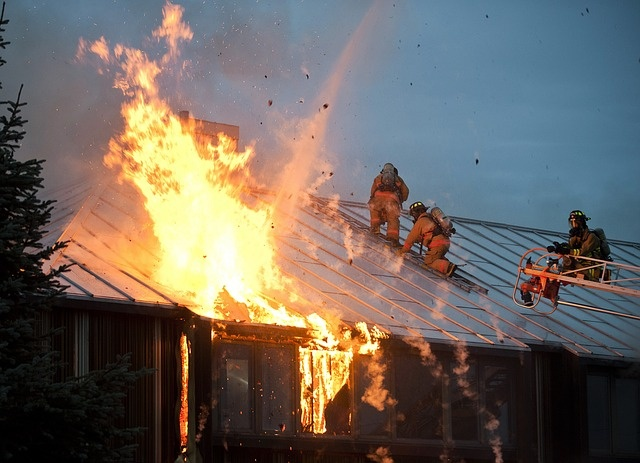

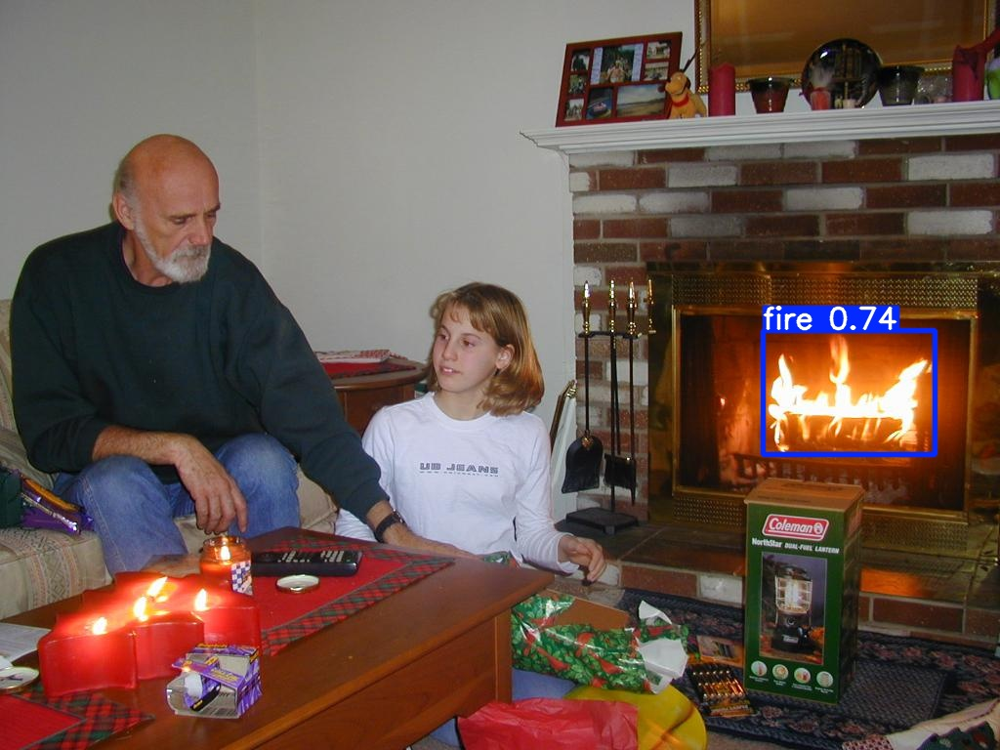

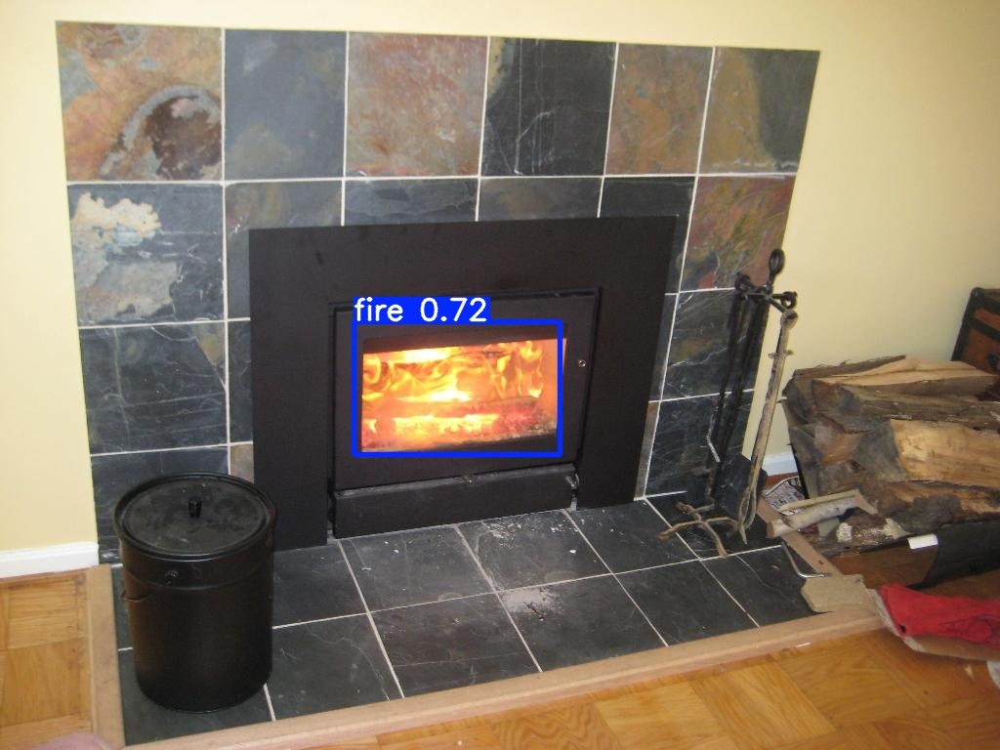

In [23]:
#display inference on some test images
# the initial one
# images = glob.glob('runs/detect/exp/*.jpg')
# Mine: exp -> exp2
images = glob.glob('runs/detect/exp2/*.jpg')

for imageName in images[:3]: #assuming JPG
    display(Image(filename=imageName, width=400))

### Prediction on Video 

In [26]:
# the initial one
# !python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.25 --source ../input.mp4
# Mine: exp -> exp4
!python detect.py --weights runs/train/exp4/weights/best.pt --img 640 --conf 0.25 --source ../input.mp4

detect: weights=['runs/train/exp4/weights/best.pt'], source=../input.mp4, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  2025-5-5 Python-3.12.8 torch-2.7.0+cpu CPU

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
video 1/1 (1/190) C:\Users\kawas\Documents\2M\English_presentation\prototype\yolov5-fire-detection-main\input.mp4: 384x640 (no detections), 145.1ms
video 1/1 (2/190) C:\Users\kawas\Documents\2M\English_presentation\prototype\yolov5-fire-detection-main\input.mp4: 384x640 (no detections), 77.2ms
video 1/1 (3/190) C:\Users\kawas\Documents\2M\English_presentat

In [29]:
import cv2
# the initial one
# vidcap = cv2.VideoCapture('runs/detect/exp2/input.mp4')
# Mine: exp2 -> exp5
vidcap = cv2.VideoCapture('runs/detect/exp5/input.mp4')
success,image = vidcap.read()
images = []
while success:
    success,image = vidcap.read()
    if success:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        images.append(image)

In [30]:
from matplotlib import animation, rc
import matplotlib.pyplot as plt

rc('animation', html='jshtml')

def create_animation(ims):
    fig = plt.figure(figsize=(9, 9))
    plt.axis('off')
    im = plt.imshow(ims[0])

    def animate_func(i):
        im.set_array(ims[i])
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames = len(ims), interval = 1000//12)

create_animation(images)

Animation size has reached 21090043 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


# Visualize feature map

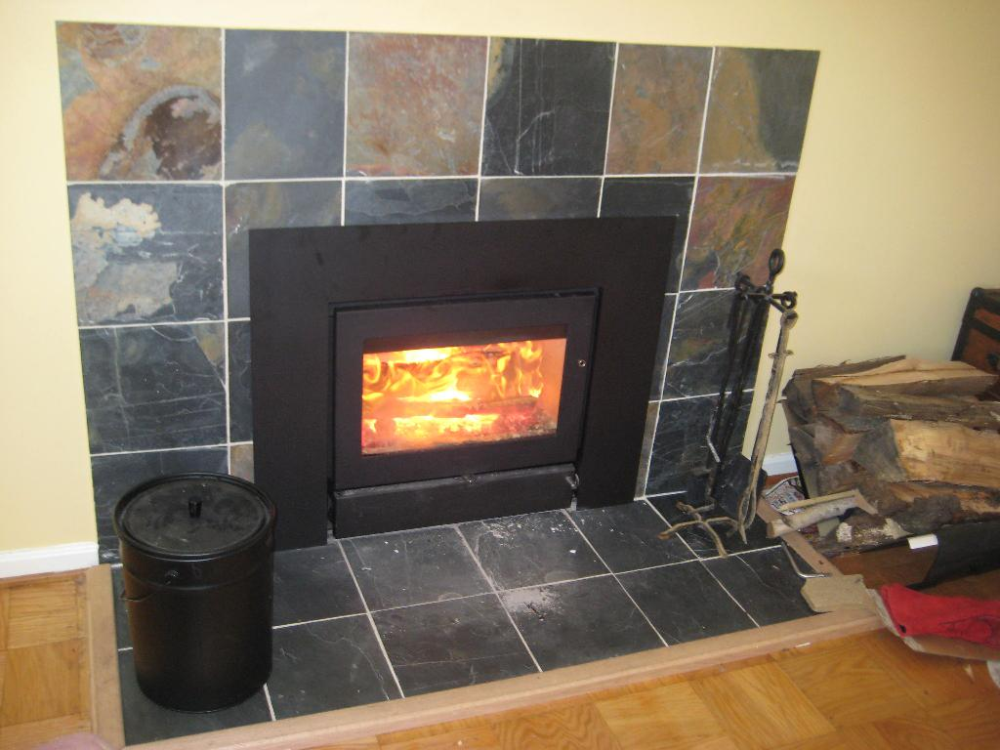

In [31]:
image_path = "../datasets/fire/val/images/004dec94c5de631f.jpg"
display(Image(filename=image_path, width=400))

In [34]:
# the initial one
# !python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.25 --source {image_path} --visualize
# Mine: exp -> exp4
!python detect.py --weights runs/train/exp4/weights/best.pt --img 640 --conf 0.25 --source {image_path} --visualize

detect: weights=['runs/train/exp4/weights/best.pt'], source=../datasets/fire/val/images/004dec94c5de631f.jpg, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=True, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  2025-5-5 Python-3.12.8 torch-2.7.0+cpu CPU

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
Saving runs\detect\exp8\004dec94c5de631f\stage0_Conv_features.png... (32/32)
Saving runs\detect\exp8\004dec94c5de631f\stage1_Conv_features.png... (32/64)
Saving runs\detect\exp8\004dec94c5de631f\stage2_C3_features.png... (32/64)
Saving runs\detect\exp8\004dec94c5de631f\stage3_Conv_features.png... (32/128)
Saving runs\dete

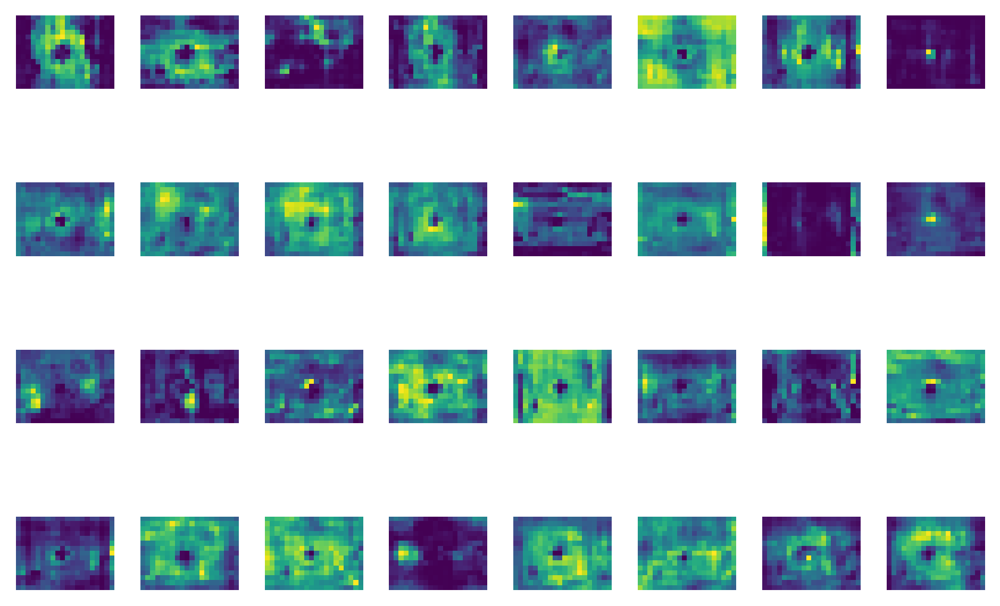

In [36]:
# the inital one
# display(Image(filename="runs/detect/exp3/004dec94c5de631f/stage23_C3_features.png"))
# Mine: exp3 -> exp8
display(Image(filename="runs/detect/exp8/004dec94c5de631f/stage23_C3_features.png"))